# Filtering Pipeline

In [1]:
from mne_bids import (BIDSPath,read_raw_bids)
import mne_bids
import mne
import importlib
import ccs_eeg_utils
from IPython.display import clear_output
import numpy as np
from matplotlib import pyplot as plt

In [2]:
def plot_data(data, sampling_rate=500, seconds=7):
    num_points = seconds * sampling_rate + 1
    plt.plot(np.arange(num_points) / sampling_rate, data[0][0].T[:num_points])
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title("EEG Signal")
    plt.show()


In [3]:
bids_root = "./data/"
subject_id = '001'


bids_path = BIDSPath(subject=subject_id, run="02", task="ContinuousVideoGamePlay",
                     datatype='eeg', suffix='eeg',
                     root=bids_root)

# read the file
raw = read_raw_bids(bids_path)
# fix the annotations readin
ccs_eeg_utils.read_annotations_core(bids_path,raw)
clear_output()

In [4]:
raw.load_data()
raw_unmodified = raw.copy()

Reading 0 ... 1398674  =      0.000 ...  2797.348 secs...


In [5]:
raw = raw_unmodified.copy()

In [33]:
#Pipeline as suggested by paper
#plot_data(raw)
raw.filter(0.01, 0.1, picks="all")
#plot_data(raw)
raw.apply_hilbert(picks="all")
# plot_data(raw)

# raw.resample(100)
# plot_data(raw, 100)


No data channels found. The highpass and lowpass values in the measurement info will not be updated.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.10 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.10 Hz)
- Filter length: 165001 samples (330.002 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    2.5s


<RawEEGLAB | sub-001_task-ContinuousVideoGamePlay_run-02_eeg.fdt, 65 x 1398675 (2797.3 s), ~1.35 GB, data loaded>

In [6]:
def create_bins(data, num_bins=8):
    bin_size = 2 * np.pi / num_bins
    bins = []
    for i in range(num_bins):
        bins.append([])
    for element in data:
        bin_index = int((element + np.pi) // bin_size)
        bins[bin_index].append(element)
    return bins

In [7]:
raw = raw_unmodified.copy()
raw.filter(0.01, 0.1, picks="all")
raw.apply_hilbert(picks="all")
test = np.angle(raw.get_data(picks="all"))


No data channels found. The highpass and lowpass values in the measurement info will not be updated.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.01 - 0.1 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.01
- Lower transition bandwidth: 0.01 Hz (-6 dB cutoff frequency: 0.01 Hz)
- Upper passband edge: 0.10 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 1.10 Hz)
- Filter length: 165001 samples (330.002 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    3.1s


In [8]:
print("tewssdt")
bins = create_bins(test[12])
print(bins)
for bin in bins:
    print(len(bin))

tewssdt
[[np.float64(-3.1405110809878614), np.float64(-3.138946628356534), np.float64(-3.137389099459285), np.float64(-3.135834643447516), np.float64(-3.13428881553719), np.float64(-3.1327547467918127), np.float64(-3.131218655985186), np.float64(-3.1296637299771124), np.float64(-3.128107496886638), np.float64(-3.126554397342659), np.float64(-3.125001725438262), np.float64(-3.123450225573196), np.float64(-3.121911899598418), np.float64(-3.120375187489745), np.float64(-3.118853289696591), np.float64(-3.1173322992516654), np.float64(-3.115805475958512), np.float64(-3.1142684745244438), np.float64(-3.112726876107063), np.float64(-3.1111946599866043), np.float64(-3.1096648827256343), np.float64(-3.108125192656377), np.float64(-3.106588905858588), np.float64(-3.1050642634447394), np.float64(-3.103540619828172), np.float64(-3.102016779442857), np.float64(-3.1004914658466736), np.float64(-3.0989551242951943), np.float64(-3.097430068998017), np.float64(-3.095907725698997), np.float64(-3.0943923

In [39]:
test.shape

(65, 1398675)

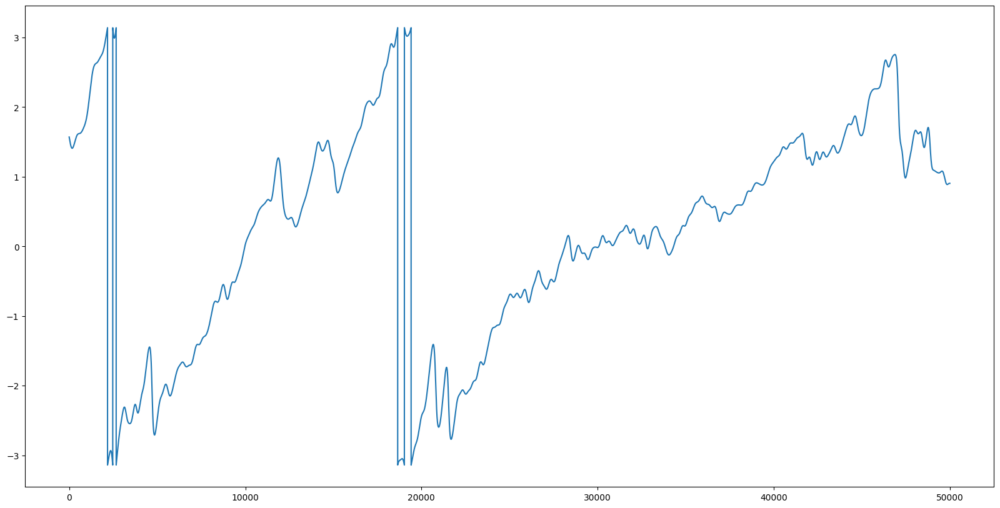

In [47]:
test
#plot it
plt.figure(figsize=(20,10))
plt.plot(test[12][:50000])

In [7]:
def phase_bin_analysis(phases, behaviors, num_bins=8):
    """
    Perform phase binning and calculate the normalized occurrence of behaviors.

    Parameters:
    -----------
    phases : np.ndarray
        Array of ISA phases (in radians) for each time point, shape (n_samples,).
    behaviors : np.ndarray
        Binary array indicating the presence (1) or absence (0) of behavior at each time point, shape (n_samples,).
    num_bins : int
        Number of bins to divide the phase into (default: 8).

    Returns:
    --------
    normalized_occurrence : np.ndarray
        Array of normalized behavior occurrences for each phase bin.
    """
    # Define bin edges and centers
    bin_edges = np.linspace(-np.pi, np.pi, num_bins + 1)  # Bins from -π to π
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2  # Compute bin centers
    
    # Assign phases to bins
    bin_indices = np.digitize(phases, bin_edges) - 1  # Bin index for each phase point
    bin_indices[bin_indices == num_bins] = num_bins - 1  # Handle edge case for the last bin
    
    # Count behaviors and phase durations for each bin
    b_i = np.array([behaviors[bin_indices == i].sum() for i in range(num_bins)])  # Behavior count
    p_i = np.array([np.sum(bin_indices == i) for i in range(num_bins)])  # Phase duration count
    
    # Normalize occurrence of behaviors
    normalized_occurrence = b_i * p_i / np.sum(b_i * p_i) if np.sum(b_i * p_i) > 0 else np.zeros(num_bins)
    
    return normalized_occurrence, bin_centers


In [15]:
# Assuming 'raw' contains your EEG data after Hilbert transform
# and 'behaviors' is an array of behavior indicators aligned with the EEG signal

# Extract the ISA phase
isa_phase = np.angle(raw.get_data(picks="all"))  # Phase of the Hilbert transform (in radians)
indices = np.where(isa_phase > 0)
print(indices)
print(len(indices))
#np.set_printoptions(threshold=np.inf)
print(isa_phase[12])

# Print indices and corresponding values


(array([ 0,  0,  0, ..., 64, 64, 64], shape=(79769318,)), array([      0,       1,       2, ..., 1398672, 1398673, 1398674],
      shape=(79769318,)))
2
[3.14159265 3.14159265 3.14159265 ... 3.14159265 3.14159265 3.14159265]


In [20]:
#
#raw.filter(0.01,0.1, picks="all")
test = raw.apply_hilbert(picks="all", envelope=True)
isa_phase = np.angle(raw.get_data(picks="all"))  # Phase of the Hilbert transform (in radians)
raw.get_data(picks="all")

array([[0.07275572, 0.05965502, 0.05966551, ..., 0.02155768, 0.02154397,
        0.02904532],
       [0.01175139, 0.00918023, 0.00918258, ..., 0.05465639, 0.05465231,
        0.0656495 ],
       [0.06312215, 0.05063096, 0.0506376 , ..., 0.038174  , 0.03816007,
        0.0490225 ],
       ...,
       [0.07684432, 0.0617616 , 0.06176742, ..., 0.04369478, 0.04366914,
        0.05630773],
       [6.39933057, 5.01141868, 5.01128147, ..., 6.1177795 , 6.11714012,
        7.65661403],
       [3.95762204, 3.1026491 , 3.10392879, ..., 3.62629984, 3.62289262,
        4.54660181]], shape=(65, 1398675))

In [22]:
isa_phase = np.angle(raw.get_data(picks="all"))  # Phase of the Hilbert transform (in radians)
isa_phase

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], shape=(65, 1398675))